In [1]:
%matplotlib inline

In [2]:
pip install markupsafe==2.0.1

Note: you may need to restart the kernel to use updated packages.


In [19]:
import pandas as pd
import pycaret
import sklearn
import matplotlib.pyplot as plt
import seaborn as sns
pd.set_option('display.max_columns', 500)
pd.set_option('display.max_rows', 500)
# EDA Libraries
import sweetviz as sv
from pandas_profiling import ProfileReport

# Load data
We start by loading only the transactions involved, to be able to select these for model training

In [4]:
trx = pd.read_csv('amlsim-data/10K/transactions.csv')
trx.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 197905 entries, 0 to 197904
Data columns (total 8 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   tran_id         197905 non-null  int64  
 1   orig_acct       197905 non-null  int64  
 2   bene_acct       197905 non-null  int64  
 3   tx_type         197905 non-null  object 
 4   base_amt        197905 non-null  float64
 5   tran_timestamp  197905 non-null  object 
 6   is_sar          197905 non-null  bool   
 7   alert_id        197905 non-null  int64  
dtypes: bool(1), float64(1), int64(4), object(2)
memory usage: 10.8+ MB


In [5]:
trx.head()

,tran_id,orig_acct,bene_acct,tx_type,base_amt,tran_timestamp,is_sar,alert_id
0,1,4376,170,TRANSFER,885.30,2017-01-01T00:00:00Z,False,-1
1,2,4300,23,TRANSFER,630.41,2017-01-01T00:00:00Z,False,-1
2,3,4433,12,TRANSFER,393.14,2017-01-01T00:00:00Z,False,-1
3,4,2552,6503,TRANSFER,659.74,2017-01-01T00:00:00Z,False,-1
4,5,2552,6503,TRANSFER,442.44,2017-01-01T00:00:00Z,False,-1


In [6]:
acc = pd.read_csv('amlsim-data/10K/accounts.csv')
acc.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12043 entries, 0 to 12042
Data columns (total 24 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   acct_id           12043 non-null  int64  
 1   dsply_nm          12043 non-null  object 
 2   type              12043 non-null  object 
 3   acct_stat         12043 non-null  object 
 4   acct_rptng_crncy  12043 non-null  object 
 5   prior_sar_count   12043 non-null  bool   
 6   branch_id         12043 non-null  int64  
 7   open_dt           12043 non-null  int64  
 8   close_dt          12043 non-null  int64  
 9   initial_deposit   12043 non-null  float64
 10  tx_behavior_id    0 non-null      float64
 11  bank_id           12043 non-null  object 
 12  first_name        12043 non-null  object 
 13  last_name         12043 non-null  object 
 14  street_addr       12043 non-null  object 
 15  city              12043 non-null  object 
 16  state             12043 non-null  object

In [9]:
acc.head()

,acct_id,dsply_nm,type,acct_stat,acct_rptng_crncy,prior_sar_count,branch_id,open_dt,close_dt,initial_deposit,tx_behavior_id,bank_id,first_name,last_name,street_addr,city,state,country,zip,gender,birth_date,ssn,lon,lat
0,0,C_0,I,A,USD,False,1,0,1000000,83514.28,NaN,bank,Emily,Blair,48764 Howard Forge Apt. 421,Vanessaside,PA,US,19763,Female,2021-12-21,701-43-7736,120.547683,-62.968225
1,1,C_1,I,A,USD,True,1,0,1000000,79773.83,NaN,bank,Dana,Nguyen,387 Grimes Green Apt. 801,Pagetown,NM,US,44165,Female,1914-10-17,196-73-3633,-51.894050,-51.749453
2,2,C_2,I,A,USD,False,1,0,1000000,68338.65,NaN,bank,Anna,Yates,15871 Arnold Squares Apt. 858,Port Carrie,LA,US,58826,Female,1949-05-16,590-31-4757,-81.286230,-39.160654
3,3,C_3,I,A,USD,False,1,0,1000000,70199.02,NaN,bank,Melinda,Massey,471 Erika Curve,North Megan,UT,US,71358,Female,1977-08-13,283-67-3859,-64.464688,68.323549
4,4,C_4,I,A,USD,True,1,0,1000000,90042.39,NaN,bank,Daniel,Norton,477 Miller Ridge Apt. 795,East Allen,DE,US,92950,Male,1951-06-25,437-08-1649,-101.424385,-31.273420


In [7]:
#To get more details about the Account holder of the transaction, lets merge Trx with accounts
df = trx.merge(
    acc,
    how='left',
    left_on='orig_acct',
    right_on='acct_id'
)

df = df.merge(
    acc,
    how='left',
    left_on='bene_acct',
    right_on='acct_id',
    suffixes=('_orig', '_bene')
)


In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 197905 entries, 0 to 197904
Data columns (total 56 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   tran_id                197905 non-null  int64  
 1   orig_acct              197905 non-null  int64  
 2   bene_acct              197905 non-null  int64  
 3   tx_type                197905 non-null  object 
 4   base_amt               197905 non-null  float64
 5   tran_timestamp         197905 non-null  object 
 6   is_sar                 197905 non-null  bool   
 7   alert_id               197905 non-null  int64  
 8   acct_id_orig           197905 non-null  int64  
 9   dsply_nm_orig          197905 non-null  object 
 10  type_orig              197905 non-null  object 
 11  acct_stat_orig         197905 non-null  object 
 12  acct_rptng_crncy_orig  197905 non-null  object 
 13  prior_sar_count_orig   197905 non-null  bool   
 14  branch_id_orig         197905 non-nu

In [11]:
df.head()

,tran_id,orig_acct,bene_acct,tx_type,base_amt,tran_timestamp,is_sar,alert_id,acct_id_orig,dsply_nm_orig,type_orig,acct_stat_orig,acct_rptng_crncy_orig,prior_sar_count_orig,branch_id_orig,open_dt_orig,close_dt_orig,initial_deposit_orig,tx_behavior_id_orig,bank_id_orig,first_name_orig,last_name_orig,street_addr_orig,city_orig,state_orig,country_orig,zip_orig,gender_orig,birth_date_orig,ssn_orig,lon_orig,lat_orig,acct_id_bene,dsply_nm_bene,type_bene,acct_stat_bene,acct_rptng_crncy_bene,prior_sar_count_bene,branch_id_bene,open_dt_bene,close_dt_bene,initial_deposit_bene,tx_behavior_id_bene,bank_id_bene,first_name_bene,last_name_bene,street_addr_bene,city_bene,state_bene,country_bene,zip_bene,gender_bene,birth_date_bene,ssn_bene,lon_bene,lat_bene
0,1,4376,170,TRANSFER,885.30,2017-01-01T00:00:00Z,False,-1,4376,C_4376,I,A,USD,False,1,0,1000000,63446.28,NaN,bank,Kristin,Gentry,9548 Hooper Manors,Sarahmouth,IA,US,98692,Female,1915-09-20,054-77-5471,90.066499,34.092692,170,C_170,I,A,USD,False,1,0,1000000,84168.61,NaN,bank,Rachel,Doyle,27020 Ashley Springs Apt. 150,Port Jeremy,ME,US,74661,Female,1979-03-23,322-84-8146,151.101223,45.779955
1,2,4300,23,TRANSFER,630.41,2017-01-01T00:00:00Z,False,-1,4300,C_4300,I,A,USD,False,1,0,1000000,79684.15,NaN,bank,Anthony,Taylor,337 Robinson Oval,West Kevintown,NM,US,86415,Male,1964-07-31,081-98-1984,-22.181147,8.679320,23,C_23,I,A,USD,False,1,0,1000000,89199.14,NaN,bank,Angel,Fisher,35833 Kelly Manor,Port Davidtown,CA,US,92535,Female,1981-03-08,427-95-2332,137.331791,23.330428
2,3,4433,12,TRANSFER,393.14,2017-01-01T00:00:00Z,False,-1,4433,C_4433,I,A,USD,False,1,0,1000000,64630.28,NaN,bank,Diana,Gray,82286 Cheryl Station,Nathanport,MS,US,87062,Female,1908-03-01,791-54-9738,-91.241754,-9.061343,12,C_12,I,A,USD,False,1,0,1000000,52909.53,NaN,bank,Brett,Kerr,29456 Kelly Neck Apt. 042,West Richardmouth,MT,US,14742,Male,1970-09-25,346-44-2037,77.207619,-58.859323
3,4,2552,6503,TRANSFER,659.74,2017-01-01T00:00:00Z,False,-1,2552,C_2552,I,A,USD,False,1,0,1000000,79188.34,NaN,bank,Debbie,Jones,35710 Gary Summit,Davidbury,RI,US,54433,Female,1987-05-28,850-93-3097,-16.454245,-39.859187,6503,C_6503,I,A,USD,False,1,0,1000000,57537.45,NaN,bank,Megan,Perry,0952 Kevin Village Apt. 324,South Oscarhaven,MO,US,85424,Female,1994-11-08,010-77-8442,-128.496888,-44.919702
4,5,2552,6503,TRANSFER,442.44,2017-01-01T00:00:00Z,False,-1,2552,C_2552,I,A,USD,False,1,0,1000000,79188.34,NaN,bank,Debbie,Jones,35710 Gary Summit,Davidbury,RI,US,54433,Female,1987-05-28,850-93-3097,-16.454245,-39.859187,6503,C_6503,I,A,USD,False,1,0,1000000,57537.45,NaN,bank,Megan,Perry,0952 Kevin Village Apt. 324,South Oscarhaven,MO,US,85424,Female,1994-11-08,010-77-8442,-128.496888,-44.919702


Doing superficial EDA using predefined libraries to get an idea about the Dataset before moving to model building

- Method 1
__SweetViz__

- Method 2 
__Pandas Profiling__


In [17]:
#EDA using Autoviz
sweet_report = sv.analyze(df)

                                             |          | [  0%]   00:00 -> (? left)

In [18]:
sweet_report.show_html('sweet_report.html')

Report sweet_report.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

/Users/pjain/opt/anaconda3/lib/python3.8/site-packages/missingno/missingno.py:254: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(
/Users/pjain/opt/anaconda3/lib/python3.8/site-packages/pandas_profiling/model/missing.py:89: UserWarning: There was an attempt to generate the Count missing values diagrams, but this failed.
To hide this warning, disable the calculation
(using `df.profile_report(missing_diagrams={"Count": False}`)
If this is problematic for your use case, please report this as an issue:
https://github.com/pandas-profiling/pandas-profiling/issues
(include the error message: 'The number of FixedLocator locations (7), usually from a call to set_ticks, does not match the number of ticklabels (56).')
  warnings.warn(


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

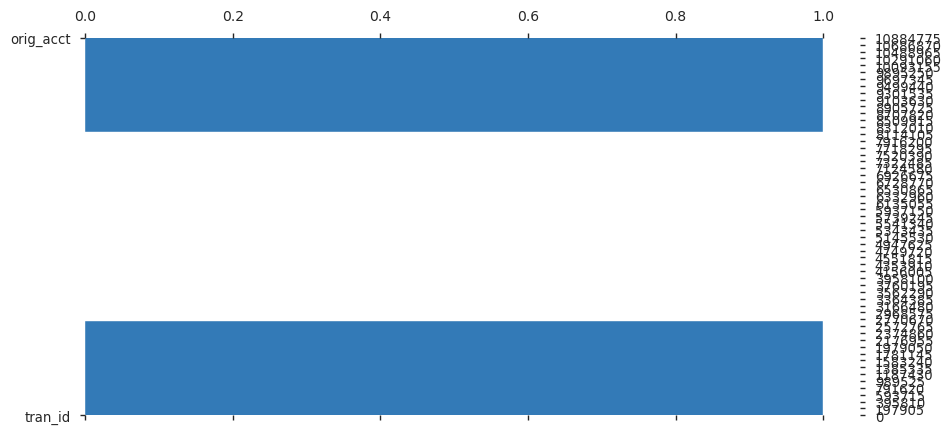

In [20]:

#EDA using pandas-profiling
profile = ProfileReport(df, explorative=True)

#Saving results to a HTML file
profile.to_file("output.html")

Analysis Results from EDA Reports

- There are no
- there are 2090 unique originators which have unique 2090 unique ssn address and like wise for beneficiaries there exist around 4077 unique beneficiary with unique details. (this shows some consistency in dataset)
- Alot of attributes just have 1 value like 
    -All the receiveng curreny is USD
    -All the accounts are based in USA
    -All the accounts have name as C_"account number"
    -and many others, Such data just add noise to the dataset and is therefore should be deleted.
- There are no missing values in the dataset except "tx_behavior_id_bene", All the values for "tx_behavior_id_bene" are missing
- A Few coloumns have very large number of categorical values, therefore its not suitable for Categorical Encoding for model production like zipcode, street addresses, city and states, also latitude and longitude details. Its best to skip these from model creation
- Removing highly correlated variables like "alert_id", 
- Distribution of age is unrealistic as it's range is from '0 years - 116 years of age'

By looking at the value counts of all the features, we can identify that few variables are same across the data and often does not add much value to the dataset. A few examples of such cases are
- 1. All the receiveng curreny is USD
- 2. All the accounts are based in USA
- 3. All the accounts have name as C_"account number"
- and many others, 
Such data just add noise to the dataset and is therefore deleted.

In [21]:
df.head(10)

,tran_id,orig_acct,bene_acct,tx_type,base_amt,tran_timestamp,is_sar,alert_id,acct_id_orig,dsply_nm_orig,type_orig,acct_stat_orig,acct_rptng_crncy_orig,prior_sar_count_orig,branch_id_orig,open_dt_orig,close_dt_orig,initial_deposit_orig,tx_behavior_id_orig,bank_id_orig,first_name_orig,last_name_orig,street_addr_orig,city_orig,state_orig,country_orig,zip_orig,gender_orig,birth_date_orig,ssn_orig,lon_orig,lat_orig,acct_id_bene,dsply_nm_bene,type_bene,acct_stat_bene,acct_rptng_crncy_bene,prior_sar_count_bene,branch_id_bene,open_dt_bene,close_dt_bene,initial_deposit_bene,tx_behavior_id_bene,bank_id_bene,first_name_bene,last_name_bene,street_addr_bene,city_bene,state_bene,country_bene,zip_bene,gender_bene,birth_date_bene,ssn_bene,lon_bene,lat_bene
0,1,4376,170,TRANSFER,885.30,2017-01-01T00:00:00Z,False,-1,4376,C_4376,I,A,USD,False,1,0,1000000,63446.28,NaN,bank,Kristin,Gentry,9548 Hooper Manors,Sarahmouth,IA,US,98692,Female,1915-09-20,054-77-5471,90.066499,34.092692,170,C_170,I,A,USD,False,1,0,1000000,84168.61,NaN,bank,Rachel,Doyle,27020 Ashley Springs Apt. 150,Port Jeremy,ME,US,74661,Female,1979-03-23,322-84-8146,151.101223,45.779955
1,2,4300,23,TRANSFER,630.41,2017-01-01T00:00:00Z,False,-1,4300,C_4300,I,A,USD,False,1,0,1000000,79684.15,NaN,bank,Anthony,Taylor,337 Robinson Oval,West Kevintown,NM,US,86415,Male,1964-07-31,081-98-1984,-22.181147,8.679320,23,C_23,I,A,USD,False,1,0,1000000,89199.14,NaN,bank,Angel,Fisher,35833 Kelly Manor,Port Davidtown,CA,US,92535,Female,1981-03-08,427-95-2332,137.331791,23.330428
2,3,4433,12,TRANSFER,393.14,2017-01-01T00:00:00Z,False,-1,4433,C_4433,I,A,USD,False,1,0,1000000,64630.28,NaN,bank,Diana,Gray,82286 Cheryl Station,Nathanport,MS,US,87062,Female,1908-03-01,791-54-9738,-91.241754,-9.061343,12,C_12,I,A,USD,False,1,0,1000000,52909.53,NaN,bank,Brett,Kerr,29456 Kelly Neck Apt. 042,West Richardmouth,MT,US,14742,Male,1970-09-25,346-44-2037,77.207619,-58.859323
3,4,2552,6503,TRANSFER,659.74,2017-01-01T00:00:00Z,False,-1,2552,C_2552,I,A,USD,False,1,0,1000000,79188.34,NaN,bank,Debbie,Jones,35710 Gary Summit,Davidbury,RI,US,54433,Female,1987-05-28,850-93-3097,-16.454245,-39.859187,6503,C_6503,I,A,USD,False,1,0,1000000,57537.45,NaN,bank,Megan,Perry,0952 Kevin Village Apt. 324,South Oscarhaven,MO,US,85424,Female,1994-11-08,010-77-8442,-128.496888,-44.919702
4,5,2552,6503,TRANSFER,442.44,2017-01-01T00:00:00Z,False,-1,2552,C_2552,I,A,USD,False,1,0,1000000,79188.34,NaN,bank,Debbie,Jones,35710 Gary Summit,Davidbury,RI,US,54433,Female,1987-05-28,850-93-3097,-16.454245,-39.859187,6503,C_6503,I,A,USD,False,1,0,1000000,57537.45,NaN,bank,Megan,Perry,0952 Kevin Village Apt. 324,South Oscarhaven,MO,US,85424,Female,1994-11-08,010-77-8442,-128.496888,-44.919702
5,6,281,75,TRANSFER,140.06,2017-01-01T00:00:00Z,False,-1,281,C_281,I,A,USD,True,1,0,1000000,87074.80,NaN,bank,Terri,Livingston,5466 Ray Orchard Suite 327,Dennisshire,DC,US,33427,Female,1943-12-03,109-41-1827,-177.699428,-37.154597,75,C_75,I,A,USD,False,1,0,1000000,50335.69,NaN,bank,Christopher,Mayer,8576 Branch Island,Jonesbury,DE,US,99020,Male,1969-05-10,725-70-3441,17.502090,-77.490069
6,7,553,400,TRANSFER,612.57,2017-01-01T00:00:00Z,False,-1,553,C_553,I,A,USD,False,1,0,1000000,76295.34,NaN,bank,Monica,Newman,55690 Jennifer Row Suite 574,New Victoriastad,HI,US,70812,Female,1913-09-16,776-46-6860,8.158774,-53.763205,400,C_400,I,A,USD,False,1,0,1000000,85853.72,NaN,bank,Vanessa,Gillespie,898 Christina Lodge Apt. 119,Perkinsport,AL,US,13342,Female,1998-06-19,593-64-5768,149.698846,20.289089
7,8,240,990,TRANSFER,665.62,2017-01-01T00:00:00Z,False,-1,240,C_240,I,A,USD,False,1,0,1000000,76874.34,NaN,bank,Travis,Richardson,780 Sanchez Forks,Kristinehaven,WV,US,4843,Male,1934-07-09,250-25-5176,-170.532140,77.683888,990,C_990,I,A,USD,False,1,0,1000000,70044.46,NaN,bank,Patrick,Coleman,4439 Lauren Via Apt. 396,South Michaeltown,AK,US,7652,Male,1962-04-01,696-54-8587,-156.829278,83.080294
8,9,668,132,TRANSFER,970.50,2017-01-01T00:00:00Z,False,-1,668,C_668,I,A,USD,False,1,0,10

In [22]:
#DROPPING Features with only 1 value
df=df.drop(df.nunique()[df.nunique()==1].index, axis=1)

In [26]:
#Dropping highly correlated values. 
df.drop(columns=["lon_bene","lat_bene","lon_orig","lat_orig","ssn_bene","ssn_orig","street_addr_orig","street_addr_bene","dsply_nm_orig","dsply_nm_bene","tx_behavior_id_orig","first_name_orig","last_name_orig","city_orig","state_orig","zip_orig","first_name_bene","last_name_bene","city_bene","state_bene","zip_bene","tx_behavior_id_bene","acct_id_orig","acct_id_bene","alert_id"],inplace=True)

In [29]:
df.head()

,tran_id,orig_acct,bene_acct,base_amt,tran_timestamp,is_sar,alert_id,acct_id_orig,prior_sar_count_orig,initial_deposit_orig,gender_orig,birth_date_orig,acct_id_bene,prior_sar_count_bene,initial_deposit_bene,gender_bene,birth_date_bene
0,1,4376,170,885.30,2017-01-01T00:00:00Z,False,-1,4376,False,63446.28,Female,1915-09-20,170,False,84168.61,Female,1979-03-23
1,2,4300,23,630.41,2017-01-01T00:00:00Z,False,-1,4300,False,79684.15,Male,1964-07-31,23,False,89199.14,Female,1981-03-08
2,3,4433,12,393.14,2017-01-01T00:00:00Z,False,-1,4433,False,64630.28,Female,1908-03-01,12,False,52909.53,Male,1970-09-25
3,4,2552,6503,659.74,2017-01-01T00:00:00Z,False,-1,2552,False,79188.34,Female,1987-05-28,6503,False,57537.45,Female,1994-11-08
4,5,2552,6503,442.44,2017-01-01T00:00:00Z,False,-1,2552,False,79188.34,Female,1987-05-28,6503,False,57537.45,Female,1994-11-08


In [42]:
#Creating a new column age from birthdate
from datetime import datetime, date
# This function converts given date to age
def age(born):
    born = datetime.strptime(born, "%Y-%m-%d").date()
    today = date.today()
    return today.year - born.year - ((today.month, today.day) < (born.month, born.day))
df['age_orig'] = df['birth_date_orig'].apply(age)
df['age_bene'] = df['birth_date_bene'].apply(age)
df.drop(columns=["birth_date_orig","birth_date_bene"],inplace=True)

In [31]:
df.head()

,tran_id,orig_acct,bene_acct,base_amt,tran_timestamp,is_sar,alert_id,acct_id_orig,prior_sar_count_orig,initial_deposit_orig,gender_orig,birth_date_orig,acct_id_bene,prior_sar_count_bene,initial_deposit_bene,gender_bene,birth_date_bene,age_orig,age_bene
0,1,4376,170,885.30,2017-01-01T00:00:00Z,False,-1,4376,False,63446.28,Female,1915-09-20,170,False,84168.61,Female,1979-03-23,106,43
1,2,4300,23,630.41,2017-01-01T00:00:00Z,False,-1,4300,False,79684.15,Male,1964-07-31,23,False,89199.14,Female,1981-03-08,58,41
2,3,4433,12,393.14,2017-01-01T00:00:00Z,False,-1,4433,False,64630.28,Female,1908-03-01,12,False,52909.53,Male,1970-09-25,114,51
3,4,2552,6503,659.74,2017-01-01T00:00:00Z,False,-1,2552,False,79188.34,Female,1987-05-28,6503,False,57537.45,Female,1994-11-08,35,27
4,5,2552,6503,442.44,2017-01-01T00:00:00Z,False,-1,2552,False,79188.34,Female,1987-05-28,6503,False,57537.45,Female,1994-11-08,35,27


In [32]:
df.shape

(197905, 19)

In [39]:
df.drop(columns=["alert_id"],inplace=True)

In [33]:
#Checking null values in the dataset
df.isnull().sum()/len(df)*100

tran_id                 0.0
orig_acct               0.0
bene_acct               0.0
base_amt                0.0
tran_timestamp          0.0
is_sar                  0.0
alert_id                0.0
acct_id_orig            0.0
prior_sar_count_orig    0.0
initial_deposit_orig    0.0
gender_orig             0.0
birth_date_orig         0.0
acct_id_bene            0.0
prior_sar_count_bene    0.0
initial_deposit_bene    0.0
gender_bene             0.0
birth_date_bene         0.0
age_orig                0.0
age_bene                0.0
dtype: float64

In [34]:
df.describe()

,tran_id,orig_acct,bene_acct,base_amt,alert_id,acct_id_orig,initial_deposit_orig,acct_id_bene,initial_deposit_bene,age_orig,age_bene
count,197905.000000,197905.000000,197905.000000,197905.000000,197905.000000,197905.000000,197905.000000,197905.000000,197905.000000,197905.000000,197905.000000
mean,98953.000000,1909.848776,569.676481,546.631910,-0.823547,1909.848776,75597.280147,569.676481,74310.106225,59.890023,58.436366
std,57130.396849,1618.013120,1695.983714,261.671165,3.472225,1618.013120,13970.572719,1695.983714,14760.157470,33.737298,31.940159
min,1.000000,0.000000,0.000000,0.090000,-1.000000,0.000000,50009.280000,0.000000,50001.550000,0.000000,0.000000
25%,49477.000000,461.000000,24.000000,319.580000,-1.000000,461.000000,63514.540000,24.000000,62535.570000,31.000000,31.000000
50%,98953.000000,2098.000000,53.000000,546.780000,-1.000000,2098.000000,76142.400000,53.000000,71210.530000,62.000000,61.000000
75%,148429.000000,2738.000000,191.000000,772.290000,-1.000000,2738.000000,87290.860000,191.000000,88048.500000,90.000000,83.000000
max,197905.000000,12007.000000,11991.000000,999.990000,99.000000,12007.000000,99999.310000,11991.000000,99999.310000,116.000000,116.000000


In [45]:
df.head(10)

,orig_acct,bene_acct,base_amt,tran_timestamp,is_sar,prior_sar_count_orig,initial_deposit_orig,gender_orig,prior_sar_count_bene,initial_deposit_bene,gender_bene,age_orig,age_bene
tran_id,,,,,,,,,,,,,
1,4376,170,885.30,2017-01-01T00:00:00Z,False,False,63446.28,Female,False,84168.61,Female,106,43
2,4300,23,630.41,2017-01-01T00:00:00Z,False,False,79684.15,Male,False,89199.14,Female,58,41
3,4433,12,393.14,2017-01-01T00:00:00Z,False,False,64630.28,Female,False,52909.53,Male,114,51
4,2552,6503,659.74,2017-01-01T00:00:00Z,False,False,79188.34,Female,False,57537.45,Female,35,27
5,2552,6503,442.44,2017-01-01T00:00:00Z,False,False,79188.34,Female,False,57537.45,Female,35,27
6,281,75,140.06,2017-01-01T00:00:00Z,False,True,87074.80,Female,False,50335.69,Male,78,53
7,553,400,612.57,2017-01-01T00:00:00Z,False,False,76295.34,Female,False,85853.72,Female,108,24
8,240,990,665.62,2017-01-01T00:00:00Z,False,False,76874.34,Male,False,70044.46,Male,88,60
9,668,132,970.50,2017-01-01T00:00:00Z,False,False,60794.76,Female,False,60784.17,Male,18,14


In [44]:
df.set_index("tran_id",inplace=True)

In [46]:
#creating pandas profiling report again to see the result of changes done


#EDA using pandas-profiling
profile = ProfileReport(df, explorative=True)

#Saving results to a HTML file
profile.to_file("eda.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

# Setup data and feature prep
PyCaret has a setup() function that prompts us with data setup out of the box. We run it here to create training/test data in the right format

In [47]:
from pycaret.classification import *

In [48]:
test = setup(data=df, target='is_sar')

,Description,Value
0,session_id,4696
1,Target,is_sar
2,Target Type,Binary
3,Label Encoded,"False: 0, True: 1"
4,Original Data,"(197905, 13)"
5,Missing Values,False
6,Numeric Features,7
7,Categorical Features,4
8,Ordinal Features,False
9,High Cardinality Features,False


In [49]:
eda()

Alert! from version 0.1.43, after importing, you must do '%matplotlib inline' to display charts in Jupyter Notebooks.
    AV = AutoViz_Class()
    dfte = AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=0, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)
Note: verbose=0 or 1 generates charts and displays them in your local Jupyter notebook.
      verbose=2 does not display plots but saves them in AutoViz_Plots folder in local machine.
Updated: chart_format='bokeh' generates and displays charts in your local Jupyter notebook.
      chart_format='server' generates and displays charts in the browser - one tab for each chart.
      chart_format='html' silently saves charts HTML format - they are also interactive!


    Since nrows is smaller than dataset, loading random sample of 150000 rows into pandas...
Shape of your Data Set loaded: (150000, 13)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
    12 Predictors classified...
        No variables removed since no ID or low-information variables found in data set
Since Number of Rows in data 150000 exceeds maximum, randomly sampling 150000 rows for EDA...

################ Binary_Classification problem #####################


Row
    [0] WidgetBox
        [0] Select(name='y', options=['base_amt', 'initial_depo...], value='base_amt')
    [1] ParamFunction(function)

Row
    [0] WidgetBox
        [0] Select(name='X-Axis', options=['base_amt', 'initial_depo...], value='base_amt')
        [1] Select(name='Y-Axis', options=['base_amt', 'initial_depo...], value='initial_deposit_orig')
        [2] Select(name='Color', options=['None', 'is_sar'], value='None')
    [1] ParamFunction(function)

Column
    [0] Row
        [0] HoloViews(DynamicMap)
        [1] Column
            [0] WidgetBox
                [0] Select(margin=(20, 20, 20, 20), options=['orig_acct', ...], value='orig_acct', width=250)
            [1] VSpacer()

Column
    [0] Row
        [0] HoloViews(DynamicMap)
        [1] Column
            [0] WidgetBox
                [0] Select(margin=(20, 20, 20, 20), options=['base_amt', 'initial_depo...], value='base_amt', width=250)
            [1] VSpacer()

HoloViews(DynamicMap)

HoloViews(Layout)

HoloViews(Overlay)

Row
    [0] WidgetBox
        [0] Select(name='X-Axis', options=['orig_acct', ...], value='orig_acct')
        [1] Select(name='Y-Axis', options=['base_amt', 'initial_depo...], value='base_amt')
    [1] ParamFunction(function)

Time to run AutoViz (in seconds) = 9


# Train various models and compare performance
The `compare_models()` function lets us train and compare various models. Here we select the best 5

In [50]:
top5 = compare_models(n_select=5)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
xgboost,Extreme Gradient Boosting,0.9992,0.9994,0.8191,0.9256,0.8674,0.8670,0.8695,4.5640
dt,Decision Tree Classifier,0.9990,0.9136,0.8277,0.8594,0.8424,0.8419,0.8424,0.1010
gbc,Gradient Boosting Classifier,0.9990,0.9994,0.7957,0.8995,0.8430,0.8425,0.8448,6.6980
rf,Random Forest Classifier,0.9989,0.9985,0.7213,0.9479,0.8152,0.8147,0.8243,1.4650
ada,Ada Boost Classifier,0.9987,0.9993,0.7468,0.8609,0.7974,0.7967,0.8000,1.6100
et,Extra Trees Classifier,0.9987,0.9975,0.6553,0.9550,0.7747,0.7741,0.7892,0.8800
lr,Logistic Regression,0.9970,0.8395,0.1447,0.8601,0.1900,0.1897,0.2745,0.9500
knn,K Neighbors Classifier,0.9970,0.6652,0.1277,0.9857,0.2241,0.2235,0.3501,0.5200
svm,SVM - Linear Kernel,0.9968,0.0000,0.0723,0.7600,0.1278,0.1275,0.2213,1.2400
ridge,Ridge Classifier,0.9966,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0630


In [51]:
print(top5)

[XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
              gamma=0, gpu_id=-1, importance_type=None,
              interaction_constraints='', learning_rate=0.300000012,
              max_delta_step=0, max_depth=6, min_child_weight=1, missing=nan,
              monotone_constraints='()', n_estimators=100, n_jobs=-1,
              num_parallel_tree=1, objective='binary:logistic',
              predictor='auto', random_state=4696, reg_alpha=0, reg_lambda=1,
              scale_pos_weight=1, subsample=1, tree_method='auto',
              use_label_encoder=True, validate_parameters=1, verbosity=0), DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=None, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,


# Evaluate model scores
Evaluate the model using graphs to interpret the results

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

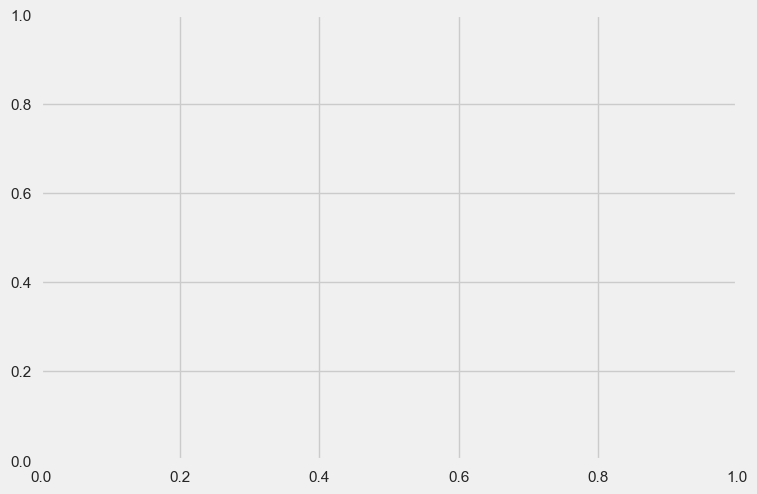

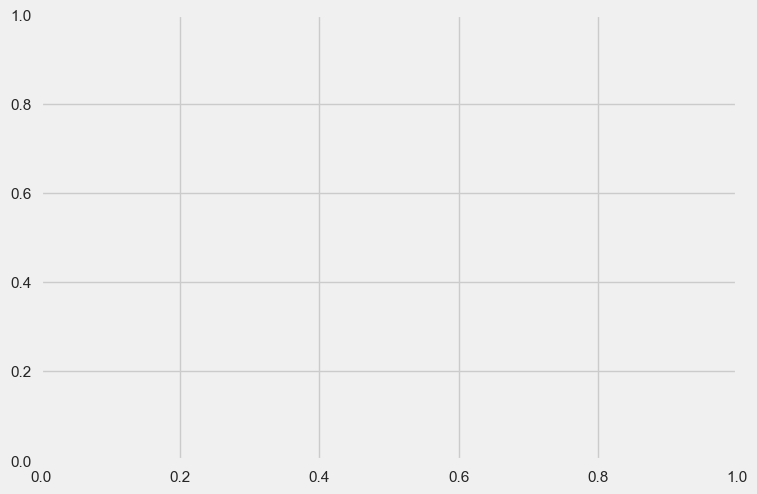

In [53]:
evaluate_model(top5[0])

In [52]:
predict_model(top5[0]);


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Extreme Gradient Boosting,0.9995,0.9996,0.8706,0.9777,0.9211,0.9208,0.9224


In [55]:
xgboost = create_model('xgboost')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.9988,0.9972,0.7234,0.9189,0.8095,0.8090,0.8148
1,0.9991,0.9999,0.7660,0.9730,0.8571,0.8567,0.8629
2,0.9995,1.0000,0.8723,0.9762,0.9213,0.9211,0.9226
3,0.9994,0.9996,0.8298,0.9750,0.8966,0.8962,0.8992
4,0.9994,0.9998,0.8511,0.9524,0.8989,0.8986,0.9000
5,0.9991,0.9998,0.8723,0.8723,0.8723,0.8719,0.8719
6,0.9994,0.9997,0.8298,0.9750,0.8966,0.8962,0.8992
7,0.9986,0.9990,0.7660,0.8182,0.7912,0.7905,0.7910
8,0.9988,0.9993,0.7447,0.8974,0.8140,0.8134,0.8169


In [64]:
 pip install explainerdashboard

Note: you may need to restart the kernel to use updated packages.


In [58]:
# generate dashboard
dashboard(xgboost)

FileNotFoundError: [Errno 2] No such file or directory: '/Users/pjain/opt/anaconda3/lib/python3.8/site-packages/click-7.1.2.dist-info/METADATA'

# Format of the Presentation


When discussing the case with us, depending on which of the above formats you
choose, we will be looking for information around specific topics such as:
- What did your initial data analysis look like, what did you learn about the
problem from looking into its context?
- Did you do any exploration in terms of data quality and/or distributions, and
what does this mean for the features that could be extracted from the data?
- What did your consideration for choosing some model architecture look like?
There are many models available, how did you narrow down to a specific set of
models and what prompted you to select this/these model(s)?
-  How did you implement your model (which libraries etc) and how did you
evaluate the outcome of the model?
-  What is your thought process about deploying this model in production,
collecting metrics, maintaining its lifecycle?

# Context

There are 4 major output files generated by the IBM AML Sim

- accounts.csv
    - This had the details of all the accounts which were in the transactions and included details like there account type, loactions details (address, names,dob etc). Few things to take notice in this file is 
        - All the details were complete expect "tx_behavior_id" which had no values. But there were no missing values in the Dataset
        - Many columns had 
